<a href="https://colab.research.google.com/github/sunshineluyao/waiting-time-eip1559/blob/main/code/Data_Analyze/Analyze_Data_The_Merge.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Part I: Set-up

In [94]:
pip install -U kaleido #tools for explorting figures

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [95]:
# mount google drive
from google.colab import drive

drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [96]:
# print the current directory
!pwd

/content/drive/My Drive/waitingtime


In [97]:
#@title path
#create a project folder and identify the path
path = "/content/drive/MyDrive/waitingtime" #@param {type:"string"}

In [98]:
#go to your project folder 
%cd /content/drive/MyDrive/waitingtime

/content/drive/MyDrive/waitingtime


In [99]:
# print the current directory again to make sure that you are in the project folder
!pwd 

/content/drive/MyDrive/waitingtime


In [100]:
import pandas as pd
import numpy as np

In [101]:
merge = pd.read_pickle('merge.pkl')
merge

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,delay_median,delay_q25%,delay_q75%,IQR,ETH2.0,merge_bn,gas_used_pct,date,congested,merge,c_congested
0,15467393,48542,30058619,9386622,2022-09-03 20:10:39,124,15206420881,4.336914,3.131631,329.703160,326.571529,0,-70000,0.312277,2022-09-03,0,before the merge,0
1,15467394,2885,30029266,3551534,2022-09-03 20:10:46,9,14492773023,4.981912,3.918423,5.125737,1.207314,0,-69999,0.118269,2022-09-03,0,before the merge,0
2,15467395,40646,30000000,6883047,2022-09-03 20:10:50,86,13109688169,253.803540,4.114839,413.202683,409.087844,0,-69998,0.229435,2022-09-03,0,before the merge,0
3,15467396,75760,30000000,16728892,2022-09-03 20:10:52,171,12222932147,379.992222,255.420531,394.048948,138.628417,0,-69997,0.557630,2022-09-03,0,before the merge,0
4,15467397,22503,30000000,3829781,2022-09-03 20:10:54,41,12399033227,6.569248,4.706410,7.638203,2.931793,0,-69996,0.127659,2022-09-03,0,before the merge,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134826,15607389,6064,30000000,1054445,2022-09-25 02:26:23,19,5318805455,12.202520,11.162012,12.424321,1.262308,1,69996,0.035148,2022-09-25,0,after the merge,0
134827,15607390,65869,30000000,16141399,2022-09-25 02:26:35,187,4700691339,13.721602,10.048979,20.423403,10.374424,1,69997,0.538047,2022-09-25,0,after the merge,0
134828,15607391,64874,30000000,11774830,2022-09-25 02:26:47,128,4745402708,10.190911,6.404940,14.110622,7.705682,1,69998,0.392494,2022-09-25,0,after the merge,0
134829,15607392,53133,30000000,11925182,2022-09-25 02:26:59,83,4617863288,10.106164,8.140298,11.451282,3.310984,1,69999,0.397506,2022-09-25,0,after the merge,0


In [102]:
merge.loc[merge['ETH2.0'] == 0, "merge"] = " before the merge"
merge.loc[merge["ETH2.0"] == 1 , "merge"] = " after the merge"

In [103]:
merge.describe()

,number,size,gas_limit,gas_used,transaction_count,base_fee_per_gas,delay_median,delay_q25%,delay_q75%,IQR,ETH2.0,merge_bn,gas_used_pct,congested,c_congested
count,1.348310e+05,134831.000000,1.348310e+05,1.348310e+05,134831.000000,1.348310e+05,134831.000000,134831.000000,134831.000000,134831.000000,134831.000000,134831.000000,134831.000000,134831.000000,134831.000000
mean,1.553758e+07,80360.994393,3.000081e+07,1.573147e+07,174.695345,1.110547e+10,23.296619,12.266790,48.688896,36.422106,0.501672,183.048765,0.524360,0.165021,0.004739
std,4.042733e+04,56735.631543,1.927519e+04,9.320365e+06,122.207039,9.773766e+09,121.384186,63.903735,227.779713,209.839223,0.499999,40427.333603,0.310656,0.371201,0.068679
min,1.546739e+07,629.000000,2.973731e+07,2.100000e+04,1.000000,1.706518e+09,0.049461,0.029905,0.106167,0.000000,0.000000,-70000.000000,0.000699,0.000000,0.000000
25%,1.550262e+07,36825.000000,3.000000e+07,7.880722e+06,85.000000,4.923015e+09,8.896253,5.884835,12.456076,4.062125,0.000000,-34776.500000,0.262690,0.000000,0.000000
50%,1.553762e+07,70769.000000,3.000000e+07,1.466354e+07,154.000000,8.027368e+09,12.893237,8.694462,16.870787,7.108361,1.000000,230.000000,0.488785,0.000000,0.000000
75%,1.557282e+07,114572.000000,3.000000e+07,2.386037e+07,244.000000,1.333507e+10,17.168911,12.630147,22.767084,12.312226,1.000000,35428.500000,0.795384,0.000000,0.000000
max,1.560739e+07,736106.000000,3.020564e+07,3.019398e+07,1418.000000,1.591882e+11,4923.262396,4787.076460,5239.595986,5205.111154,1.000000,70000.000000,1.000000,1.000000,1.000000


In [104]:
#@title Define the congestion threshold
cut = 0.95 #@param {type:"number"}



In [105]:
merge['congested'] = merge['gas_used_pct'].apply(lambda x: 1 if x>= cut else 0)
merge

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,delay_median,delay_q25%,delay_q75%,IQR,ETH2.0,merge_bn,gas_used_pct,date,congested,merge,c_congested
0,15467393,48542,30058619,9386622,2022-09-03 20:10:39,124,15206420881,4.336914,3.131631,329.703160,326.571529,0,-70000,0.312277,2022-09-03,0,before the merge,0
1,15467394,2885,30029266,3551534,2022-09-03 20:10:46,9,14492773023,4.981912,3.918423,5.125737,1.207314,0,-69999,0.118269,2022-09-03,0,before the merge,0
2,15467395,40646,30000000,6883047,2022-09-03 20:10:50,86,13109688169,253.803540,4.114839,413.202683,409.087844,0,-69998,0.229435,2022-09-03,0,before the merge,0
3,15467396,75760,30000000,16728892,2022-09-03 20:10:52,171,12222932147,379.992222,255.420531,394.048948,138.628417,0,-69997,0.557630,2022-09-03,0,before the merge,0
4,15467397,22503,30000000,3829781,2022-09-03 20:10:54,41,12399033227,6.569248,4.706410,7.638203,2.931793,0,-69996,0.127659,2022-09-03,0,before the merge,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134826,15607389,6064,30000000,1054445,2022-09-25 02:26:23,19,5318805455,12.202520,11.162012,12.424321,1.262308,1,69996,0.035148,2022-09-25,0,after the merge,0
134827,15607390,65869,30000000,16141399,2022-09-25 02:26:35,187,4700691339,13.721602,10.048979,20.423403,10.374424,1,69997,0.538047,2022-09-25,0,after the merge,0
134828,15607391,64874,30000000,11774830,2022-09-25 02:26:47,128,4745402708,10.190911,6.404940,14.110622,7.705682,1,69998,0.392494,2022-09-25,0,after the merge,0
134829,15607392,53133,30000000,11925182,2022-09-25 02:26:59,83,4617863288,10.106164,8.140298,11.451282,3.310984,1,69999,0.397506,2022-09-25,0,after the merge,0


In [106]:
# congested for continued 5 blocks
merge['c_congested'] = merge['congested'].rolling(5).sum()>=5
merge['c_congested']= merge['c_congested'].astype(int)
merge.describe()

,number,size,gas_limit,gas_used,transaction_count,base_fee_per_gas,delay_median,delay_q25%,delay_q75%,IQR,ETH2.0,merge_bn,gas_used_pct,congested,c_congested
count,1.348310e+05,134831.000000,1.348310e+05,1.348310e+05,134831.000000,1.348310e+05,134831.000000,134831.000000,134831.000000,134831.000000,134831.000000,134831.000000,134831.000000,134831.000000,134831.000000
mean,1.553758e+07,80360.994393,3.000081e+07,1.573147e+07,174.695345,1.110547e+10,23.296619,12.266790,48.688896,36.422106,0.501672,183.048765,0.524360,0.165021,0.004739
std,4.042733e+04,56735.631543,1.927519e+04,9.320365e+06,122.207039,9.773766e+09,121.384186,63.903735,227.779713,209.839223,0.499999,40427.333603,0.310656,0.371201,0.068679
min,1.546739e+07,629.000000,2.973731e+07,2.100000e+04,1.000000,1.706518e+09,0.049461,0.029905,0.106167,0.000000,0.000000,-70000.000000,0.000699,0.000000,0.000000
25%,1.550262e+07,36825.000000,3.000000e+07,7.880722e+06,85.000000,4.923015e+09,8.896253,5.884835,12.456076,4.062125,0.000000,-34776.500000,0.262690,0.000000,0.000000
50%,1.553762e+07,70769.000000,3.000000e+07,1.466354e+07,154.000000,8.027368e+09,12.893237,8.694462,16.870787,7.108361,1.000000,230.000000,0.488785,0.000000,0.000000
75%,1.557282e+07,114572.000000,3.000000e+07,2.386037e+07,244.000000,1.333507e+10,17.168911,12.630147,22.767084,12.312226,1.000000,35428.500000,0.795384,0.000000,0.000000
max,1.560739e+07,736106.000000,3.020564e+07,3.019398e+07,1418.000000,1.591882e+11,4923.262396,4787.076460,5239.595986,5205.111154,1.000000,70000.000000,1.000000,1.000000,1.000000


In [107]:
merge.to_csv("merge.csv")
merge.to_pickle("merge.pkl")

# Part II: Visualization

### A. the median of the waiting time (delay)

In [108]:
import plotly.express as px
merge_fig = merge.loc[merge.delay_median<40]
fig = px.density_heatmap(merge_fig, x="number", y="delay_median")
fig.update_layout(
            title={
            'text' : "The Density Heatmap for the Median of Waiting Time (delay) by Blocks",
            'x':0.5,
            'xanchor': 'center'
        })
fig.show()
fig.write_image("image/fig1.png")
fig.write_html("image/fig1.html")

In [109]:
fig = px.density_contour(merge_fig, x="number", y="delay_median")
fig.update_traces(contours_coloring="fill", contours_showlabels = True)
fig.update_layout(
            title={
            'text' : "The Density Contour for the Median of Waiting Time (delay) by Blocks",
            'x':0.5,
            'xanchor': 'center'
        })
fig.show()
fig.write_image("image/fig2.png")
fig.write_html("image/fig2.html")

In [110]:
import plotly.express as px
merge_fig.loc[merge_fig['ETH2.0'] == 0, "merge"] = " before the merge"
merge_fig.loc[merge_fig["ETH2.0"] == 1 , "merge"] = " after the merge"

fig= px.histogram(merge_fig, x="delay_median", color="merge", histnorm = "percent", marginal = "box", barmode='overlay', labels={"merge": ""})
fig.update_layout(
    xaxis = dict(title="Median waiting time by Block (s)"),
    yaxis = dict(title = "percent"),
    font = dict(size = 24)
)
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.6,
    xanchor="left",
    x=0.7),
    font = dict(size = 24))
fig.update_layout(
            title={
            'text' : "The Histogram for the Median of Waiting Time (delay) Before and After the Merge",
            'x':0.5,
            'xanchor': 'center'
        })

fig.show()
fig.write_image("image/fig3.png")
fig.write_html("image/fig3.html")

/usr/local/lib/python3.8/dist-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [111]:
import plotly.express as px
fig = px.box(merge, x="merge", y="delay_median", points="all")
fig.update_layout(yaxis_range=[0,100])
fig.update_layout(
            title={
            'text' : "The Box Plot for the Median of Waiting Time (delay) Before and After the Merge",
            'x':0.5,
            'xanchor': 'center'
        })
fig.show()
fig.write_image("image/fig4.png")
fig.write_html("image/fig4.html")

### B. the gas used percentage

In [112]:
import plotly.express as px
fig = px.density_heatmap(merge, x="number", y="gas_used_pct")
fig.update_layout(
            title={
            'text' : "The Density Heatmap of Gas Used Percentage by Block Before and After the Merge",
            'x':0.5,
            'xanchor': 'center'
        })
fig.show()
fig.write_image("image/fig5.png")
fig.write_html("image/fig5.html")

In [113]:
fig = px.density_contour(merge, x="number", y="gas_used_pct")
fig.update_traces(contours_coloring="fill", contours_showlabels = True)
fig.update_layout(
            title={
            'text' : "The Density Heatmap of Gas Used Percentage by Block Before and After the Merge",
            'x':0.5,
            'xanchor': 'center'
        })
fig.show()
fig.write_image("image/fig6.png")
fig.write_html("image/fig6.html")

In [114]:
import plotly.express as px

fig = px.histogram(merge_fig, x="gas_used_pct", color="merge", histnorm = "percent", marginal = "box", barmode='overlay', labels={"merge": ""})
fig.update_layout(
    xaxis = dict(title="the percent of gas used (the ratio of gas used and gas limit)"),
    yaxis = dict(title = "percent"),
    font = dict(size = 24)
)
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.6,
    xanchor="left",
    x=0.7),
    font = dict(size = 24))
fig.update_layout(
            title={
            'text' : "The Histogram of Gas Used Percentage by Block Before and After the Merge",
            'x':0.5,
            'xanchor': 'center'
        })
fig.show()
fig.write_image("image/fig7.png")
fig.write_html("image/fig7.html")

### C. the base fee per gas

In [115]:
import plotly.graph_objects as go

In [116]:
# https://plotly.com/python/smoothing/
x=merge.number
y=merge.base_fee_per_gas
def smoothTriangle(data, degree):
    triangle=np.concatenate((np.arange(degree + 1), np.arange(degree)[::-1])) # up then down
    smoothed=[]

    for i in range(degree, len(data) - degree * 2):
        point=data[i:i + len(triangle)] * triangle
        smoothed.append(np.sum(point)/np.sum(triangle))
    # Handle boundaries
    smoothed=[smoothed[0]]*int(degree + degree/2) + smoothed
    while len(smoothed) < len(data):
        smoothed.append(smoothed[-1])
    return smoothed

fig = go.Figure()
fig.add_trace(go.Scatter(
    x=x,
    y=y,
    mode='markers',
    marker=dict(
        size=6,
        color='#5E88FC',
        symbol='circle-open'
    ),
    name='Gas Fee Per Gas'
))

fig.add_trace(go.Scatter(
    x=x,
    y=smoothTriangle(y, 100),  # setting degree to 10
    mode='markers',
    marker=dict(
        size=6,
        color='#C190F0',
        symbol='triangle-up'
    ),
    name='Moving Triangle - Degree 100'
))

fig.add_trace(go.Scatter(
        name='The Merge',
        x = [15537393, 15537393],
        y = [merge.base_fee_per_gas.min(), merge.base_fee_per_gas.max()],
        
        mode = "lines",
        marker = dict(color = 'rgba(80, 26, 80, 0.8)')
    ))

fig.update_layout(
            title={
            'text' : "The Gas Fee Per Gas Time Series and Its Moving Triangle of Degree 100 before and after the merge",
            'x':0.5,
            'xanchor': 'center'
        })
fig.show()
fig.write_image("image/fig8.png")
fig.write_html("image/fig8.html")

In [117]:
# https://plotly.com/python/smoothing/
x=merge.number
y=merge.transaction_count
def smoothTriangle(data, degree):
    triangle=np.concatenate((np.arange(degree + 1), np.arange(degree)[::-1])) # up then down
    smoothed=[]

    for i in range(degree, len(data) - degree * 2):
        point=data[i:i + len(triangle)] * triangle
        smoothed.append(np.sum(point)/np.sum(triangle))
    # Handle boundaries
    smoothed=[smoothed[0]]*int(degree + degree/2) + smoothed
    while len(smoothed) < len(data):
        smoothed.append(smoothed[-1])
    return smoothed

fig = go.Figure()
fig.add_trace(go.Scatter(
    x=x,
    y=y,
    mode='markers',
    marker=dict(
        size=6,
        color='#5E88FC',
        symbol='circle-open'
    ),
    name='Transaction Count'
))

fig.add_trace(go.Scatter(
    x=x,
    y=smoothTriangle(y, 100),  # setting degree to 10
    mode='markers',
    marker=dict(
        size=6,
        color='#C190F0',
        symbol='triangle-up'
    ),
    name='Moving Triangle - Degree 100'
))

fig.add_trace(go.Scatter(
        name='The Merge',
        x = [15537393, 15537393],
        y = [merge.transaction_count.min(), merge.transaction_count.max()],
        
        mode = "lines",
        marker = dict(color = 'rgba(80, 26, 80, 0.8)')
    ))

fig.update_layout(
            title={
            'text' : "The Transaction Count Time Series and Its Moving Triangle of Degree 100 before and after the merge",
            'x':0.5,
            'xanchor': 'center'
        })
fig.show()
fig.write_image("image/fig9.png")
fig.write_html("image/fig9.html")

### D. Congestion Ratio Based on Cuts

In [118]:
cuts = [
    dict(
        cut=i * 0.01,
        name=f'cut_{i}'
    ) for i in np.linspace(0, 100, 500)
]

In [119]:
merge_before =merge[merge['ETH2.0']==0]
merge_after = merge[merge['ETH2.0']==1]
merge_before

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,delay_median,delay_q25%,delay_q75%,IQR,ETH2.0,merge_bn,gas_used_pct,date,congested,merge,c_congested
0,15467393,48542,30058619,9386622,2022-09-03 20:10:39,124,15206420881,4.336914,3.131631,329.703160,326.571529,0,-70000,0.312277,2022-09-03,0,before the merge,0
1,15467394,2885,30029266,3551534,2022-09-03 20:10:46,9,14492773023,4.981912,3.918423,5.125737,1.207314,0,-69999,0.118269,2022-09-03,0,before the merge,0
2,15467395,40646,30000000,6883047,2022-09-03 20:10:50,86,13109688169,253.803540,4.114839,413.202683,409.087844,0,-69998,0.229435,2022-09-03,0,before the merge,0
3,15467396,75760,30000000,16728892,2022-09-03 20:10:52,171,12222932147,379.992222,255.420531,394.048948,138.628417,0,-69997,0.557630,2022-09-03,0,before the merge,0
4,15467397,22503,30000000,3829781,2022-09-03 20:10:54,41,12399033227,6.569248,4.706410,7.638203,2.931793,0,-69996,0.127659,2022-09-03,0,before the merge,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67185,15537388,19789,30000000,15109407,2022-09-15 06:42:13,114,37190466833,6.713943,4.018190,7.904129,3.885939,0,-5,0.503647,2022-09-15,0,before the merge,0
67186,15537389,36493,30029295,26226335,2022-09-15 06:42:22,175,37224374311,5.392669,2.937186,8.054955,5.117769,0,-4,0.873358,2022-09-15,0,before the merge,0
67187,15537390,7807,30000000,6893891,2022-09-15 06:42:30,46,40698882159,4.296373,3.913505,4.646714,0.733209,0,-3,0.229796,2022-09-15,0,before the merge,0
67188,15537391,47274,30000000,16969164,2022-09-15 06:42:35,105,37949635702,3.494231,2.759944,3.906301,1.146357,0,-2,0.565639,2022-09-15,0,before the merge,0


In [120]:
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots

In [121]:
from tqdm import tqdm
Cuts_before = []

for cut in tqdm(cuts):
    merge_before.loc[:,cut.get('name')] = merge_before['gas_used_pct'] > cut.get('cut')
    congested = merge_before.loc[:, cut.get('name')].sum()
    not_congested = len(merge_before.loc[:, cut.get('name')]) - congested
    Cuts_before.append(dict(
        cut=cut.get('cut'),
        congested=congested,
        not_congested=not_congested,
    ))

Cuts_before = pd.DataFrame(Cuts_before)
Cuts_before

  0%|          | 0/500 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/pandas/core/indexing.py:1667: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
100%|██████████| 500/500 [00:00<00:00, 926.87it/s]


,cut,congested,not_congested
0,0.000000,67190,0
1,0.002004,67167,23
2,0.004008,67140,50
3,0.006012,67097,93
4,0.008016,67050,140
...,...,...,...
495,0.991984,13769,53421
496,0.993988,13652,53538
497,0.995992,13500,53690
498,0.997996,13143,54047


In [122]:
Cuts_before['congestion_ratio'] = Cuts_before['congested']/(Cuts_before['congested']+ Cuts_before['not_congested'])*100
Cuts_before

,cut,congested,not_congested,congestion_ratio
0,0.000000,67190,0,100.000000
1,0.002004,67167,23,99.965769
2,0.004008,67140,50,99.925584
3,0.006012,67097,93,99.861587
4,0.008016,67050,140,99.791636
...,...,...,...,...
495,0.991984,13769,53421,20.492633
496,0.993988,13652,53538,20.318500
497,0.995992,13500,53690,20.092276
498,0.997996,13143,54047,19.560947


In [123]:
from tqdm import tqdm
Cuts_after = []

for cut in tqdm(cuts):
    merge_after.loc[:, cut.get('name')] = merge_after['gas_used_pct'] > cut.get('cut')
    congested = merge_after.loc[:, cut.get('name')].sum()
    not_congested = len(merge_after.loc[:, cut.get('name')]) - congested
    Cuts_after.append(dict(
        cut=cut.get('cut'),
        congested=congested,
        not_congested=not_congested,
    ))

Cuts_after = pd.DataFrame(Cuts_after)
Cuts_after

  0%|          | 0/500 [00:00<?, ?it/s]/usr/local/lib/python3.8/dist-packages/pandas/core/indexing.py:1667: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
100%|██████████| 500/500 [00:00<00:00, 915.77it/s]


,cut,congested,not_congested
0,0.000000,67641,0
1,0.002004,67602,39
2,0.004008,67558,83
3,0.006012,67527,114
4,0.008016,67475,166
...,...,...,...
495,0.991984,5288,62353
496,0.993988,5157,62484
497,0.995992,4988,62653
498,0.997996,4673,62968


In [124]:
Cuts_after['congestion_ratio'] = Cuts_after['congested']/(Cuts_after['congested']+ Cuts_after['not_congested'])*100
Cuts_after

,cut,congested,not_congested,congestion_ratio
0,0.000000,67641,0,100.000000
1,0.002004,67602,39,99.942343
2,0.004008,67558,83,99.877293
3,0.006012,67527,114,99.831463
4,0.008016,67475,166,99.754587
...,...,...,...,...
495,0.991984,5288,62353,7.817744
496,0.993988,5157,62484,7.624074
497,0.995992,4988,62653,7.374226
498,0.997996,4673,62968,6.908532


In [125]:
Cuts_before.to_csv('Cuts_before.csv')
Cuts_before.to_pickle('Cuts_before.pkl')
Cuts_after.to_csv('Cuts_after.csv')
Cuts_after.to_pickle('Cuts_after.pkl')

In [126]:
fig = make_subplots()

fig.add_trace(go.Scatter(
    x=Cuts_before['cut'],
    y=Cuts_before['congestion_ratio'],
    mode='lines',
    #stackgroup='one',
    #groupnorm='percent',
    name='congestion ratio before the merge'
))



fig.add_trace(go.Scatter(
    x=Cuts_after['cut'],
    y=Cuts_after['congestion_ratio'],
    mode='lines',
    #stackgroup='two',
    #groupnorm='percent',
    name='congestion ratio after the merge'
))

fig.update_layout(dict(
    title='Congestion Ratio Under Different Cuts Before and After the Merge',
    width=800,
    height=600,
))

fig.update_xaxes(
    rangeslider=dict(
        visible=True
    ),
)

fig.update_yaxes(dict(title='Percent', showgrid=True))
fig.update_xaxes(dict(title='Cut', showgrid=True))

fig.show()
fig.write_image("image/fig10.png")
fig.write_html("image/fig10.html")



### E. Congested for more than 5 continous blocks


In [127]:
merge.groupby('ETH2.0')['c_congested'].mean()*100

ETH2.0
0    0.619140
1    0.329682
Name: c_congested, dtype: float64

In [128]:
merge_ccongested  = merge.loc[merge.c_congested==1]

In [129]:
merge_ccongested.to_csv("merge_ccongested.csv")
merge_ccongested.to_pickle("merge_ccongested.pkl")

In [130]:
# https://plotly.com/python/smoothing/
x=merge_ccongested.number
y=merge_ccongested.gas_used_pct*100
def smoothTriangle(data, degree):
    triangle=np.concatenate((np.arange(degree + 1), np.arange(degree)[::-1])) # up then down
    smoothed=[]

    for i in range(degree, len(data) - degree * 2):
        point=data[i:i + len(triangle)] * triangle
        smoothed.append(np.sum(point)/np.sum(triangle))
    # Handle boundaries
    smoothed=[smoothed[0]]*int(degree + degree/2) + smoothed
    while len(smoothed) < len(data):
        smoothed.append(smoothed[-1])
    return smoothed

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x,
    y=y,
    mode='markers',
    marker=dict(
        size=6,
        color='#5E88FC',
        symbol='triangle-up'
    ),
    name='Continued Congested Blocks'
))


fig.add_trace(go.Scatter(
        name='The Merge',
        x = [15537393, 15537393],
        y = [95, 100],
        
        mode = "lines",
        marker = dict(color = 'rgba(80, 26, 80, 0.8)')
    ))
fig.update_xaxes(title='block number')
fig.update_yaxes(title='Gas Used Percentage')
fig.update_layout(
            title={
            'text' : "Continued Congested Blocks (Gas Used Percentage>95%) for at Least the Past 5 Blocks (including the current)",
            'x':0.5,
            'xanchor': 'center'
        })

fig.show()
fig.write_image("image/fig11.png")
fig.write_html("image/fig11.html")

# Part III: Statistic Tests And Statistic Smoothing

## 3.1 The Statistic Tests

In [ ]:
import scipy
from scipy.stats import mannwhitneyu

In [ ]:
merge_before = merge.loc[merge["ETH2.0"]==0]
merge_after = merge.loc[merge["ETH2.0"]==1]

In [ ]:
# T-test
x = merge_before['congested']
y = merge_after['congested']
#pg.mwu(x, y, alternative='two-sided')
scipy.stats.mannwhitneyu(x, y, use_continuity=True, alternative='greater')

MannwhitneyuResult(statistic=2552997020.0, pvalue=0.0)

In [ ]:
x = merge_before['c_congested']
y = merge_after['c_congested']
#pg.mwu(x, y, alternative='two-sided')
scipy.stats.mannwhitneyu(x, y, use_continuity=True, alternative='greater')

MannwhitneyuResult(statistic=2278977038.0, pvalue=5.054079505077552e-15)

In [ ]:
# T-test
x = merge_before['delay_median']
y = merge_after['delay_median']
#pg.mwu(x, y, alternative='two-sided')
scipy.stats.mannwhitneyu(x, y, use_continuity=True, alternative='greater')

MannwhitneyuResult(statistic=1979333086.5, pvalue=1.0)

In [ ]:
merge

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,delay_median,delay_q25%,delay_q75%,IQR,ETH2.0,merge_bn,gas_used_pct,date,congested,merge,c_congested
0,15467393,48542,30058619,9386622,2022-09-03 20:10:39,124,15206420881,4.336914,3.131631,329.703160,326.571529,0,-70000,0.312277,2022-09-03,0,before the merge,0
1,15467394,2885,30029266,3551534,2022-09-03 20:10:46,9,14492773023,4.981912,3.918423,5.125737,1.207314,0,-69999,0.118269,2022-09-03,0,before the merge,0
2,15467395,40646,30000000,6883047,2022-09-03 20:10:50,86,13109688169,253.803540,4.114839,413.202683,409.087844,0,-69998,0.229435,2022-09-03,0,before the merge,0
3,15467396,75760,30000000,16728892,2022-09-03 20:10:52,171,12222932147,379.992222,255.420531,394.048948,138.628417,0,-69997,0.557630,2022-09-03,0,before the merge,0
4,15467397,22503,30000000,3829781,2022-09-03 20:10:54,41,12399033227,6.569248,4.706410,7.638203,2.931793,0,-69996,0.127659,2022-09-03,0,before the merge,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134826,15607389,6064,30000000,1054445,2022-09-25 02:26:23,19,5318805455,12.202520,11.162012,12.424321,1.262308,1,69996,0.035148,2022-09-25,0,after the merge,0
134827,15607390,65869,30000000,16141399,2022-09-25 02:26:35,187,4700691339,13.721602,10.048979,20.423403,10.374424,1,69997,0.538047,2022-09-25,0,after the merge,0
134828,15607391,64874,30000000,11774830,2022-09-25 02:26:47,128,4745402708,10.190911,6.404940,14.110622,7.705682,1,69998,0.392494,2022-09-25,0,after the merge,0
134829,15607392,53133,30000000,11925182,2022-09-25 02:26:59,83,4617863288,10.106164,8.140298,11.451282,3.310984,1,69999,0.397506,2022-09-25,0,after the merge,0


In [ ]:
# T-test
x = merge_before['IQR']
y = merge_after['IQR']
#pg.mwu(x, y, alternative='two-sided')
scipy.stats.mannwhitneyu(x, y, use_continuity=True, alternative='greater')

MannwhitneyuResult(statistic=2941807116.5, pvalue=0.0)

In [ ]:
# T-test
x = merge_before['delay_q75%']
y = merge_after['delay_q75%']
#pg.mwu(x, y, alternative='two-sided')
scipy.stats.mannwhitneyu(x, y, use_continuity=True, alternative='greater')

MannwhitneyuResult(statistic=2440575004.5, pvalue=9.106730043354256e-123)

## 3.2. The Regression Discontinuity Visualization

In [ ]:
import plotnine as p
#https://plotnine.readthedocs.io/en/stable/generated/plotnine.themes.theme.html

/usr/local/lib/python3.8/dist-packages/plotnine/stats/stat_smooth.py:175: PlotnineWarning: No 'window' specified in the method_args. Using window = 13483. The same window is used for all groups or facets
/usr/local/lib/python3.8/dist-packages/plotnine/layer.py:401: PlotnineWarning: geom_point : Removed 2009 rows containing missing values.
/usr/local/lib/python3.8/dist-packages/plotnine/guides/guides.py:197: PlotnineWarning: Cannot generate legend for the 'fill' aesthetic. Make sure you have mapped a variable to it


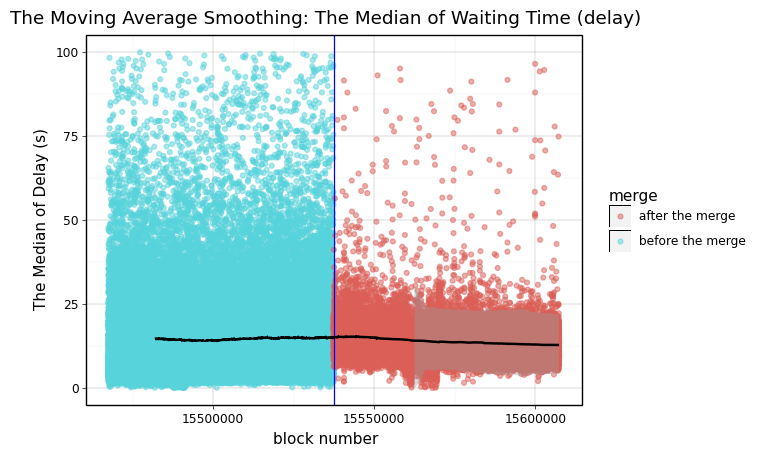

In [ ]:
# https://ggplot2.tidyverse.org/reference/geom_quantile.html
# https://ggplot2.tidyverse.org/reference/scale_brewer.html
# https://r-charts.com/ggplot2/themes/
# https://plotnine.readthedocs.io/en/stable/generated/plotnine.stats.stat_smooth.html

fig, plot = (p.ggplot(merge, p.aes(x='number', y='delay_median', color = 'merge')) +\
            p.ylim(0,100) +\
            p.geom_point(alpha = 0.5) +\
            p.geom_vline(xintercept = 15537393, colour = "blue") +\
            p.stat_smooth(method = "mavg", se = 'True',color="black") +\
            p.labs(x = "block number", y = "The Median of Delay (s)")+\
            p.theme_linedraw()+\
            p.scale_fill_brewer(palette=10)+\
            p.ggtitle("The Moving Average Smoothing: The Median of Waiting Time (delay)")).draw(show=True, return_ggplot=True)
fig.savefig('image/fig12.png', dpi=600)

In [ ]:
merge

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,delay_median,delay_q25%,delay_q75%,IQR,ETH2.0,merge_bn,gas_used_pct,date,congested,merge,c_congested
0,15467393,48542,30058619,9386622,2022-09-03 20:10:39,124,15206420881,4.336914,3.131631,329.703160,326.571529,0,-70000,0.312277,2022-09-03,0,before the merge,0
1,15467394,2885,30029266,3551534,2022-09-03 20:10:46,9,14492773023,4.981912,3.918423,5.125737,1.207314,0,-69999,0.118269,2022-09-03,0,before the merge,0
2,15467395,40646,30000000,6883047,2022-09-03 20:10:50,86,13109688169,253.803540,4.114839,413.202683,409.087844,0,-69998,0.229435,2022-09-03,0,before the merge,0
3,15467396,75760,30000000,16728892,2022-09-03 20:10:52,171,12222932147,379.992222,255.420531,394.048948,138.628417,0,-69997,0.557630,2022-09-03,0,before the merge,0
4,15467397,22503,30000000,3829781,2022-09-03 20:10:54,41,12399033227,6.569248,4.706410,7.638203,2.931793,0,-69996,0.127659,2022-09-03,0,before the merge,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134826,15607389,6064,30000000,1054445,2022-09-25 02:26:23,19,5318805455,12.202520,11.162012,12.424321,1.262308,1,69996,0.035148,2022-09-25,0,after the merge,0
134827,15607390,65869,30000000,16141399,2022-09-25 02:26:35,187,4700691339,13.721602,10.048979,20.423403,10.374424,1,69997,0.538047,2022-09-25,0,after the merge,0
134828,15607391,64874,30000000,11774830,2022-09-25 02:26:47,128,4745402708,10.190911,6.404940,14.110622,7.705682,1,69998,0.392494,2022-09-25,0,after the merge,0
134829,15607392,53133,30000000,11925182,2022-09-25 02:26:59,83,4617863288,10.106164,8.140298,11.451282,3.310984,1,69999,0.397506,2022-09-25,0,after the merge,0


/usr/local/lib/python3.8/dist-packages/plotnine/stats/stat_smooth.py:175: PlotnineWarning: No 'window' specified in the method_args. Using window = 13483. The same window is used for all groups or facets
/usr/local/lib/python3.8/dist-packages/plotnine/layer.py:401: PlotnineWarning: geom_point : Removed 5363 rows containing missing values.
/usr/local/lib/python3.8/dist-packages/plotnine/guides/guides.py:197: PlotnineWarning: Cannot generate legend for the 'fill' aesthetic. Make sure you have mapped a variable to it


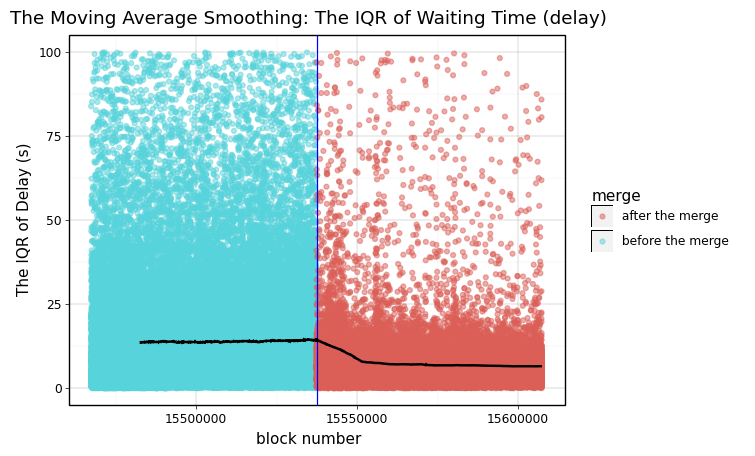

In [ ]:
fig, plot = (p.ggplot(merge, p.aes(x='number', y='IQR', color = 'merge')) +\
            p.ylim(0,100) +\
            p.geom_point(alpha = 0.5) +\
            p.geom_vline(xintercept = 15537393, colour = "blue") +\
            p.stat_smooth(method = "mavg", se = 'True',color="black") +\
            p.labs(x = "block number", y = "The IQR of Delay (s)")+\
            p.theme_linedraw()+\
            p.scale_fill_brewer(palette=10)+\
            p.ggtitle("The Moving Average Smoothing: The IQR of Waiting Time (delay)")).draw(show=True, return_ggplot=True)
fig.savefig('image/fig13.png', dpi=600)

/usr/local/lib/python3.8/dist-packages/plotnine/stats/stat_smooth.py:175: PlotnineWarning: No 'window' specified in the method_args. Using window = 13483. The same window is used for all groups or facets
/usr/local/lib/python3.8/dist-packages/plotnine/layer.py:401: PlotnineWarning: geom_point : Removed 6042 rows containing missing values.
/usr/local/lib/python3.8/dist-packages/plotnine/guides/guides.py:197: PlotnineWarning: Cannot generate legend for the 'fill' aesthetic. Make sure you have mapped a variable to it


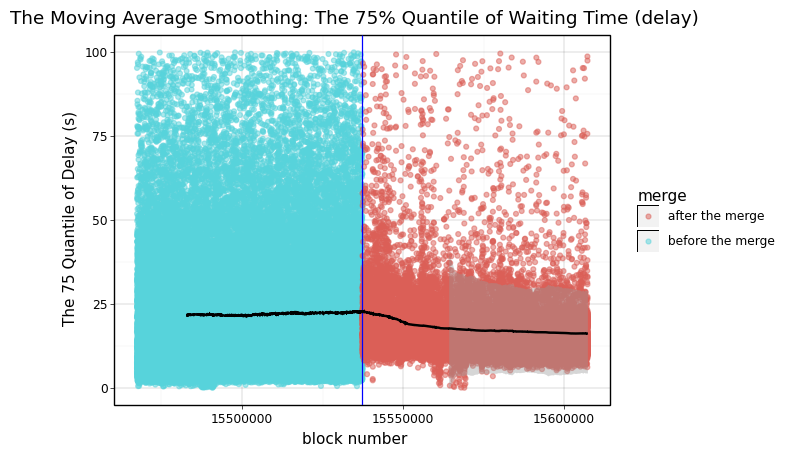

In [ ]:
fig, plot = (p.ggplot(merge, p.aes(x='number', y='delay_q75%', color = 'merge')) +\
            p.ylim(0,100) +\
            p.geom_point(alpha = 0.5) +\
            p.geom_vline(xintercept = 15537393, colour = "blue") +\
            p.stat_smooth(method = "mavg", se = 'True',color="black") +\
            p.labs(x = "block number", y = "The 75 Quantile of Delay (s)")+\
            p.theme_linedraw()+\
            p.scale_fill_brewer(palette=10)+\
            p.ggtitle("The Moving Average Smoothing: The 75% Quantile of Waiting Time (delay)")).draw(show=True, return_ggplot=True)
fig.savefig('image/fig14.png', dpi=600)

/usr/local/lib/python3.8/dist-packages/plotnine/stats/stat_smooth.py:175: PlotnineWarning: No 'window' specified in the method_args. Using window = 13483. The same window is used for all groups or facets
/usr/local/lib/python3.8/dist-packages/plotnine/guides/guides.py:197: PlotnineWarning: Cannot generate legend for the 'fill' aesthetic. Make sure you have mapped a variable to it


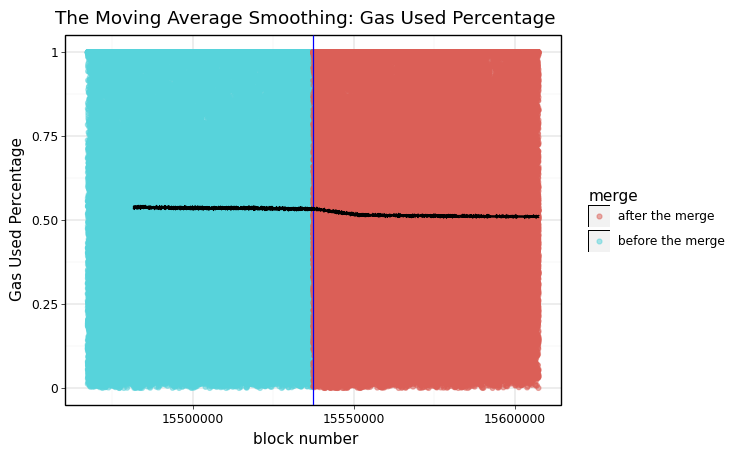

In [ ]:
# https://ggplot2.tidyverse.org/reference/geom_quantile.html
# https://ggplot2.tidyverse.org/reference/scale_brewer.html
# https://r-charts.com/ggplot2/themes/
# https://plotnine.readthedocs.io/en/stable/generated/plotnine.stats.stat_smooth.html

fig, plot = (p.ggplot(merge, p.aes(x='number', y='gas_used_pct', color = 'merge')) +\
            p.ylim(0,1) +\
            p.geom_point(alpha = 0.5) +\
            p.geom_vline(xintercept = 15537393, colour = "blue") +\
            p.stat_smooth(method = "mavg", se = 'True',color="black") +\
            p.labs(x = "block number", y = "Gas Used Percentage")+\
            p.theme_linedraw()+\
            p.scale_fill_brewer(palette=10)+\
            p.ggtitle("The Moving Average Smoothing: Gas Used Percentage")).draw(show=True, return_ggplot=True)
fig.savefig('image/fig15.png', dpi=600)

In [ ]:
# https://pbpython.com/groupby-agg.html
merge_date_congested = merge.groupby(['date'],as_index=False).agg({'congested': ['mean']})

merge_date_congested.columns = [
'_'.join(col).rstrip('_') for col in merge_date_congested.columns.values
]
merge_date_congested

,date,congested_mean
0,2022-09-03,0.262876
1,2022-09-04,0.243568
2,2022-09-05,0.232267
3,2022-09-06,0.219569
4,2022-09-07,0.217054
5,2022-09-08,0.228812
6,2022-09-09,0.226051
7,2022-09-10,0.224093
8,2022-09-11,0.235839
9,2022-09-12,0.226231


In [ ]:
from datetime import date
merge_date_congested['date_merge'] = date(2022, 9, 15)
merge_date_congested['days_after_merge'] = (merge_date_congested['date']-merge_date_congested['date_merge']).dt.days
merge_date_congested['merge']=0
merge_date_congested.loc[merge_date_congested.days_after_merge<0,'merge']='before the merge'
merge_date_congested.loc[merge_date_congested.days_after_merge>=0,'merge']='after the merge'
merge_date_congested.columns = ['date', 'congested_ratio','date_merge','days_after_merge','merge']
merge_date_congested

,date,congested_ratio,date_merge,days_after_merge,merge
0,2022-09-03,0.262876,2022-09-15,-12,before the merge
1,2022-09-04,0.243568,2022-09-15,-11,before the merge
2,2022-09-05,0.232267,2022-09-15,-10,before the merge
3,2022-09-06,0.219569,2022-09-15,-9,before the merge
4,2022-09-07,0.217054,2022-09-15,-8,before the merge
5,2022-09-08,0.228812,2022-09-15,-7,before the merge
6,2022-09-09,0.226051,2022-09-15,-6,before the merge
7,2022-09-10,0.224093,2022-09-15,-5,before the merge
8,2022-09-11,0.235839,2022-09-15,-4,before the merge
9,2022-09-12,0.226231,2022-09-15,-3,before the merge


/usr/local/lib/python3.8/dist-packages/plotnine/stats/stat_smooth.py:175: PlotnineWarning: No 'window' specified in the method_args. Using window = 2. The same window is used for all groups or facets
/usr/local/lib/python3.8/dist-packages/plotnine/guides/guides.py:197: PlotnineWarning: Cannot generate legend for the 'fill' aesthetic. Make sure you have mapped a variable to it


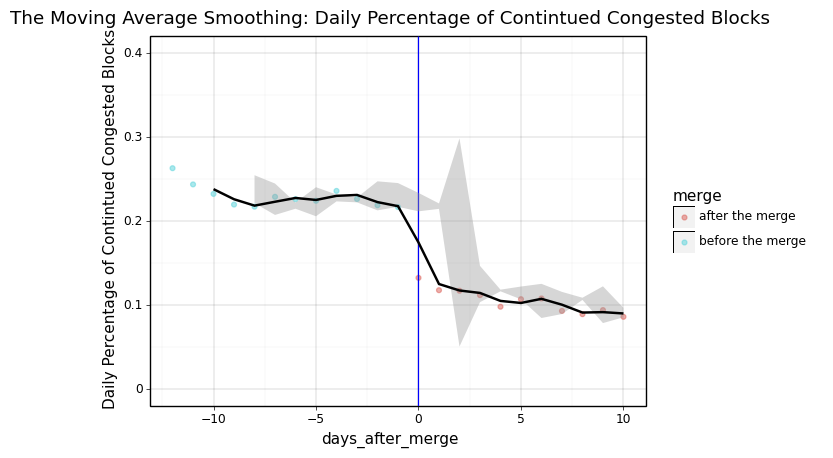

In [ ]:
# https://ggplot2.tidyverse.org/reference/geom_quantile.html
# https://ggplot2.tidyverse.org/reference/scale_brewer.html
# https://r-charts.com/ggplot2/themes/
# https://plotnine.readthedocs.io/en/stable/generated/plotnine.stats.stat_smooth.html

fig, plot = (p.ggplot(merge_date_congested, p.aes(x='days_after_merge', y='congested_ratio', color = 'merge')) +\
            p.ylim(0,0.4) +\
            p.geom_point(alpha = 0.5) +\
            p.geom_vline(xintercept = 0, colour = "blue") +\
            p.stat_smooth(method = "mavg", se = 'True',color="black") +\
            p.labs(x = "days_after_merge", y = "Daily Percentage of Contintued Congested Blocks")+\
            p.theme_linedraw()+\
            p.scale_fill_brewer(palette=10)+\
            p.ggtitle("The Moving Average Smoothing: Daily Percentage of Contintued Congested Blocks")).draw(show=True, return_ggplot=True)
fig.savefig('image/fig17.png', dpi=600)


In [ ]:
# https://pbpython.com/groupby-agg.html
merge_date_c_congested = merge.groupby(['date'],as_index=False).agg({'c_congested': ['mean']})

merge_date_c_congested.columns = [
'_'.join(col).rstrip('_') for col in merge_date_c_congested.columns.values
]
merge_date_c_congested

,date,c_congested_mean
0,2022-09-03,0.006438
1,2022-09-04,0.009021
2,2022-09-05,0.003217
3,2022-09-06,0.006512
4,2022-09-07,0.005056
5,2022-09-08,0.007600
6,2022-09-09,0.005169
7,2022-09-10,0.005843
8,2022-09-11,0.006008
9,2022-09-12,0.008892


In [ ]:
from datetime import date
merge_date_c_congested['date_merge'] = date(2022, 9, 15)
merge_date_c_congested['days_after_merge'] = (merge_date_c_congested['date']-merge_date_c_congested['date_merge']).dt.days
merge_date_c_congested['merge']=0
merge_date_c_congested.loc[merge_date_c_congested.days_after_merge<0,'merge']='before the merge'
merge_date_c_congested.loc[merge_date_c_congested.days_after_merge>=0,'merge']='after the merge'
merge_date_c_congested.columns = ['date', 'congested_ratio','date_merge','days_after_merge','merge']

merge_date_c_congested

,date,congested_ratio,date_merge,days_after_merge,merge
0,2022-09-03,0.006438,2022-09-15,-12,before the merge
1,2022-09-04,0.009021,2022-09-15,-11,before the merge
2,2022-09-05,0.003217,2022-09-15,-10,before the merge
3,2022-09-06,0.006512,2022-09-15,-9,before the merge
4,2022-09-07,0.005056,2022-09-15,-8,before the merge
5,2022-09-08,0.007600,2022-09-15,-7,before the merge
6,2022-09-09,0.005169,2022-09-15,-6,before the merge
7,2022-09-10,0.005843,2022-09-15,-5,before the merge
8,2022-09-11,0.006008,2022-09-15,-4,before the merge
9,2022-09-12,0.008892,2022-09-15,-3,before the merge


/usr/local/lib/python3.8/dist-packages/plotnine/stats/stat_smooth.py:175: PlotnineWarning: No 'window' specified in the method_args. Using window = 2. The same window is used for all groups or facets
/usr/local/lib/python3.8/dist-packages/plotnine/guides/guides.py:197: PlotnineWarning: Cannot generate legend for the 'fill' aesthetic. Make sure you have mapped a variable to it


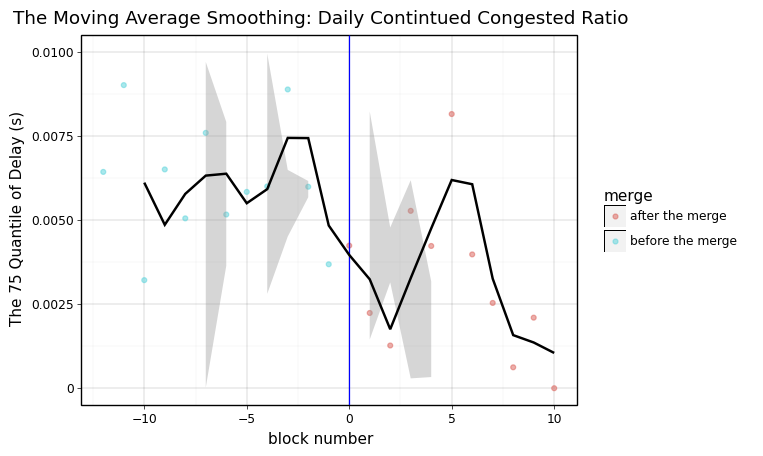

In [ ]:
# https://ggplot2.tidyverse.org/reference/geom_quantile.html
# https://ggplot2.tidyverse.org/reference/scale_brewer.html
# https://r-charts.com/ggplot2/themes/
# https://plotnine.readthedocs.io/en/stable/generated/plotnine.stats.stat_smooth.html


fig, plot = (p.ggplot(merge_date_c_congested, p.aes(x='days_after_merge', y='congested_ratio', color = 'merge')) +\
            p.ylim(0,0.01) +\
            p.geom_point(alpha = 0.5) +\
            p.geom_vline(xintercept = 0, colour = "blue") +\
            p.stat_smooth(method = "mavg", se = 'True',color="black") +\
            p.labs(x = "block number", y = "The 75 Quantile of Delay (s)")+\
            p.theme_linedraw()+\
            p.scale_fill_brewer(palette=10)+\
            p.ggtitle("The Moving Average Smoothing: Daily Contintued Congested Ratio")).draw(show=True, return_ggplot=True)
fig.savefig('image/fig18.png', dpi=600)

# Part IV: The Regressions 

## 4.1. Preparations

In [ ]:
!pip install stargazer
!pip install linearmodels

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.5 MB 4.7 MB/s 
     |████████████████████████████████| 68 kB 5.4 MB/s 


In [ ]:
# Import Regression Packages
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
import statsmodels.formula.api as smf
# Install package for model comparison

from stargazer.stargazer import Stargazer
from IPython.core.display import HTML
from linearmodels import PooledOLS
import statsmodels.api as sm
from linearmodels import PanelOLS


In [ ]:
merge = pd.read_pickle('merge.pkl')
merge

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,delay_median,delay_q25%,delay_q75%,IQR,ETH2.0,merge_bn,gas_used_pct,date,congested,merge,c_congested
0,15467393,48542,30058619,9386622,2022-09-03 20:10:39,124,15206420881,4.336914,3.131631,329.703160,326.571529,0,-70000,0.312277,2022-09-03,0,before the merge,0
1,15467394,2885,30029266,3551534,2022-09-03 20:10:46,9,14492773023,4.981912,3.918423,5.125737,1.207314,0,-69999,0.118269,2022-09-03,0,before the merge,0
2,15467395,40646,30000000,6883047,2022-09-03 20:10:50,86,13109688169,253.803540,4.114839,413.202683,409.087844,0,-69998,0.229435,2022-09-03,0,before the merge,0
3,15467396,75760,30000000,16728892,2022-09-03 20:10:52,171,12222932147,379.992222,255.420531,394.048948,138.628417,0,-69997,0.557630,2022-09-03,0,before the merge,0
4,15467397,22503,30000000,3829781,2022-09-03 20:10:54,41,12399033227,6.569248,4.706410,7.638203,2.931793,0,-69996,0.127659,2022-09-03,0,before the merge,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134826,15607389,6064,30000000,1054445,2022-09-25 02:26:23,19,5318805455,12.202520,11.162012,12.424321,1.262308,1,69996,0.035148,2022-09-25,0,after the merge,0
134827,15607390,65869,30000000,16141399,2022-09-25 02:26:35,187,4700691339,13.721602,10.048979,20.423403,10.374424,1,69997,0.538047,2022-09-25,0,after the merge,0
134828,15607391,64874,30000000,11774830,2022-09-25 02:26:47,128,4745402708,10.190911,6.404940,14.110622,7.705682,1,69998,0.392494,2022-09-25,0,after the merge,0
134829,15607392,53133,30000000,11925182,2022-09-25 02:26:59,83,4617863288,10.106164,8.140298,11.451282,3.310984,1,69999,0.397506,2022-09-25,0,after the merge,0


In [ ]:
merge.columns=['number', 'size', 'gas_limit', 'gas_used', 'timestamp',
       'transaction_count', 'base_fee_per_gas', 'delay_median', 'delay_q25',
       'delay_q75', 'IQR', 'merged', 'blockn', 'gas_used_pct', 'date',
       'congested', 'merge', 'c_congested']

##4.2. RDD for congested

## 4.3. RDD for Continued Congested

## 4.4. Quantile Regression 75% for Gas Used Percentage

## 4.5 RDD for 75% Quantiles of Delay

In [ ]:
results1 = smf.ols('delay_q75 ~ 1 + merged', data=merge).fit()
results2 = smf.ols('delay_q75 ~ 1 + merged + blockn + merged:blockn', data=merge).fit()
results3 = smf.ols('delay_q75 ~ 1 + merged + blockn + merged:blockn', data=merge).fit()

stargazer = Stargazer([results1 ,results2, results3])
stargazer.title('The 75% Quantile of Waiting Time (delay) before and after the merge')
stargazer.covariate_order(['merged','blockn','merged:blockn'])
HTML(stargazer.render_html())

In [ ]:
print(stargazer.render_latex())

\begin{table}[!htbp] \centering
  \caption{The 75% Quantile of Waiting Time (delay) before and after the merge}
\begin{tabular}{@{\extracolsep{5pt}}lccc}
\\[-1.8ex]\hline
\hline \\[-1.8ex]
& \multicolumn{3}{c}{\textit{Dependent variable:}} \
\cr \cline{3-4}
\\[-1.8ex] & (1) & (2) & (3) \\
\hline \\[-1.8ex]
 merged & -32.942$^{***}$ & -21.261$^{***}$ & -21.261$^{***}$ \\
  & (1.237) & (2.471) & (2.471) \\
 blockn & & -0.000$^{}$ & -0.000$^{}$ \\
  & & (0.000) & (0.000) \\
 merged:blockn & & -0.000$^{***}$ & -0.000$^{***}$ \\
  & & (0.000) & (0.000) \\
\hline \\[-1.8ex]
 Observations & 134,831 & 134,831 & 134,831 \\
 $R^2$ & 0.005 & 0.006 & 0.006 \\
 Adjusted $R^2$ & 0.005 & 0.006 & 0.006 \\
 Residual Std. Error & 227.184(df = 134829) & 227.142(df = 134827) & 227.142(df = 134827)  \\
 F Statistic & 708.729$^{***}$ (df = 1.0; 134829.0) & 253.883$^{***}$ (df = 3.0; 134827.0) & 253.883$^{***}$ (df = 3.0; 134827.0) \\
\hline
\hline \\[-1.8ex]
\textit{Note:} & \multicolumn{3}{r}{$^{*}$p$<$0.1

## 4.6 RDD for IQR of Delay

In [ ]:
results1 = smf.ols('IQR ~ 1 + merged', data=merge).fit()
results2 = smf.ols('IQR ~ 1 + merged + blockn + merged:blockn', data=merge).fit()
results3 = smf.ols('IQR ~ 1 + merged + blockn + merged:blockn', data=merge).fit()

stargazer = Stargazer([results1 ,results2, results3])
stargazer.title('IQR of Waiting Time (delay) before and after the merge')
stargazer.covariate_order(['merged','blockn','merged:blockn'])
HTML(stargazer.render_html())

In [ ]:
print(stargazer.render_latex())

\begin{table}[!htbp] \centering
  \caption{IQR of Waiting Time (delay) before and after the merge}
\begin{tabular}{@{\extracolsep{5pt}}lccc}
\\[-1.8ex]\hline
\hline \\[-1.8ex]
& \multicolumn{3}{c}{\textit{Dependent variable:}} \
\cr \cline{3-4}
\\[-1.8ex] & (1) & (2) & (3) \\
\hline \\[-1.8ex]
 merged & -32.269$^{***}$ & -26.057$^{***}$ & -26.057$^{***}$ \\
  & (1.140) & (2.276) & (2.276) \\
 blockn & & 0.000$^{}$ & 0.000$^{}$ \\
  & & (0.000) & (0.000) \\
 merged:blockn & & -0.000$^{***}$ & -0.000$^{***}$ \\
  & & (0.000) & (0.000) \\
\hline \\[-1.8ex]
 Observations & 134,831 & 134,831 & 134,831 \\
 $R^2$ & 0.006 & 0.006 & 0.006 \\
 Adjusted $R^2$ & 0.006 & 0.006 & 0.006 \\
 Residual Std. Error & 209.219(df = 134829) & 209.193(df = 134827) & 209.193(df = 134827)  \\
 F Statistic & 801.865$^{***}$ (df = 1.0; 134829.0) & 279.302$^{***}$ (df = 3.0; 134827.0) & 279.302$^{***}$ (df = 3.0; 134827.0) \\
\hline
\hline \\[-1.8ex]
\textit{Note:} & \multicolumn{3}{r}{$^{*}$p$<$0.1; $^{**}$p$<$0.

In [ ]:
results1 = smf.logit('congested ~ 1 + merged', data=merge).fit()
results2 = smf.logit('congested ~ 1 + merged + blockn + merged:blockn', data=merge).fit()
results3 = smf.logit('congested ~ 1 + merged + blockn + merged:blockn', data=merge).fit()

stargazer = Stargazer([results1 ,results2, results3])
stargazer.title('The Logit Regression for Market Congestion (>95% gas used) before and after the merge')
stargazer.covariate_order(['merged','blockn','merged:blockn'])
stargazer.significant_digits(3)
HTML(stargazer.render_html())

Optimization terminated successfully.
         Current function value: 0.433794
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.433606
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.433606
         Iterations 6


In [ ]:
print(stargazer.render_latex())

\begin{table}[!htbp] \centering
  \caption{The Logit Regression for Market Congestion (>95% gas used) before and after the merge}
\begin{tabular}{@{\extracolsep{5pt}}lccc}
\\[-1.8ex]\hline
\hline \\[-1.8ex]
& \multicolumn{3}{c}{\textit{Dependent variable:}} \
\cr \cline{3-4}
\\[-1.8ex] & (1) & (2) & (3) \\
\hline \\[-1.8ex]
 merged & -0.934$^{***}$ & -0.749$^{***}$ & -0.749$^{***}$ \\
  & (0.016) & (0.031) & (0.031) \\
 blockn & & -0.000$^{***}$ & -0.000$^{***}$ \\
  & & (0.000) & (0.000) \\
 merged:blockn & & -0.000$^{***}$ & -0.000$^{***}$ \\
  & & (0.000) & (0.000) \\
\hline \\[-1.8ex]
 Observations & 134,831 & 134,831 & 134,831 \\
 $R^2$ &  &  &  \\
 Adjusted $R^2$ &  &  &  \\
 Residual Std. Error & 1.000(df = 134829) & 1.000(df = 134827) & 1.000(df = 134827)  \\
 F Statistic & $^{}$ (df = 1.0; 134829.0) & $^{}$ (df = 3.0; 134827.0) & $^{}$ (df = 3.0; 134827.0) \\
\hline
\hline \\[-1.8ex]
\textit{Note:} & \multicolumn{3}{r}{$^{*}$p$<$0.1; $^{**}$p$<$0.05; $^{***}$p$<$0.01} \\
\end{

In [ ]:
results1 = smf.logit('c_congested ~ 1 + merged', data=merge).fit()
results2 = smf.logit('c_congested ~ 1 + merged + blockn + merged:blockn', data=merge).fit()
results3 = smf.logit('c_congested ~ 1 + merged + blockn + merged:blockn', data=merge).fit()

stargazer = Stargazer([results1 ,results2, results3])
stargazer.title('The Logit Regression for Market Continued Congestion (>95% gas used) before and after the merge')
stargazer.covariate_order(['merged','blockn','merged:blockn'])
stargazer.significant_digits(3)
HTML(stargazer.render_html())

Optimization terminated successfully.
         Current function value: 0.029867
         Iterations 10
Optimization terminated successfully.
         Current function value: 0.029864
         Iterations 9
Optimization terminated successfully.
         Current function value: 0.029864
         Iterations 9


In [ ]:
print(stargazer.render_latex())

\begin{table}[!htbp] \centering
  \caption{The Logit Regression for Market Continued Congestion (>95% gas used) before and after the merge}
\begin{tabular}{@{\extracolsep{5pt}}lccc}
\\[-1.8ex]\hline
\hline \\[-1.8ex]
& \multicolumn{3}{c}{\textit{Dependent variable:}} \
\cr \cline{3-4}
\\[-1.8ex] & (1) & (2) & (3) \\
\hline \\[-1.8ex]
 merged & -0.633$^{***}$ & -0.529$^{***}$ & -0.529$^{***}$ \\
  & (0.083) & (0.164) & (0.164) \\
 blockn & & -0.000$^{}$ & -0.000$^{}$ \\
  & & (0.000) & (0.000) \\
 merged:blockn & & -0.000$^{}$ & -0.000$^{}$ \\
  & & (0.000) & (0.000) \\
\hline \\[-1.8ex]
 Observations & 134,831 & 134,831 & 134,831 \\
 $R^2$ &  &  &  \\
 Adjusted $R^2$ &  &  &  \\
 Residual Std. Error & 1.000(df = 134829) & 1.000(df = 134827) & 1.000(df = 134827)  \\
 F Statistic & $^{}$ (df = 1.0; 134829.0) & $^{}$ (df = 3.0; 134827.0) & $^{}$ (df = 3.0; 134827.0) \\
\hline
\hline \\[-1.8ex]
\textit{Note:} & \multicolumn{3}{r}{$^{*}$p$<$0.1; $^{**}$p$<$0.05; $^{***}$p$<$0.01} \\
\end{ta

In [ ]:
results1 = smf.quantreg('gas_used_pct ~ 1 + merged', data=merge).fit(q=0.75)
results2 = smf.quantreg('gas_used_pct~ 1 + merged + blockn + merged:blockn', data=merge).fit(q=0.75)
results3 = smf.quantreg('gas_used_pct ~ 1 + merged + blockn + merged:blockn', data=merge).fit(q=0.75)

stargazer = Stargazer([results1 ,results2, results3])
stargazer.title('The Quantile Regression for Block Gase Used before and after the merge')
stargazer.covariate_order(['merged','blockn','merged:blockn'])
stargazer.significant_digits(3)
HTML(stargazer.render_html())